In [1]:
import numpy as np
import tensorflow as tf
import keras
import cv2
from keras.layers import MaxPool2D,Conv2D,UpSampling2D,Input,Dropout
from keras.models import Sequential
from tensorflow.keras.utils import img_to_array
import os
from tqdm import tqdm
import re
import matplotlib.pyplot as plt

In [2]:
# to get the files in proper order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 160
color_img = []
path = '../DATA/landscapeImages/color'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):    
      
    img = cv2.imread(path + '/'+i,1)
    # open cv reads images in BGR format so we have to convert it to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    color_img.append(img_to_array(img))


gray_img = []
path = '../DATA/landscapeImages/gray'
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
    img = cv2.imread(path + '/'+i,1)

    #resizing image
    img = cv2.resize(img, (SIZE, SIZE))
    img = img.astype('float32') / 255.0
    gray_img.append(img_to_array(img))


100%|██████████| 7129/7129 [00:06<00:00, 1142.41it/s]


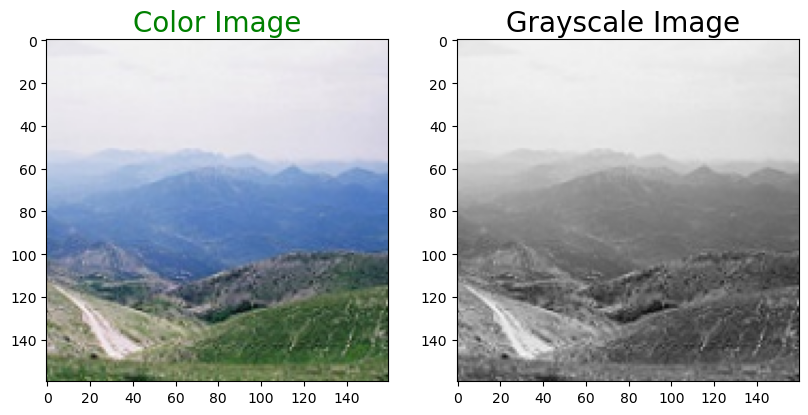

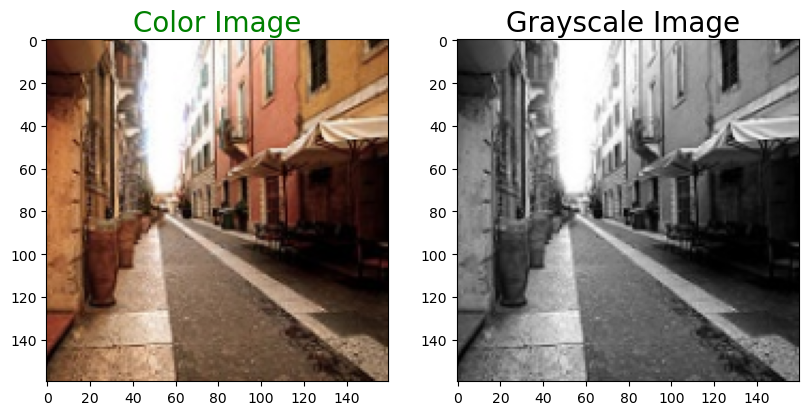

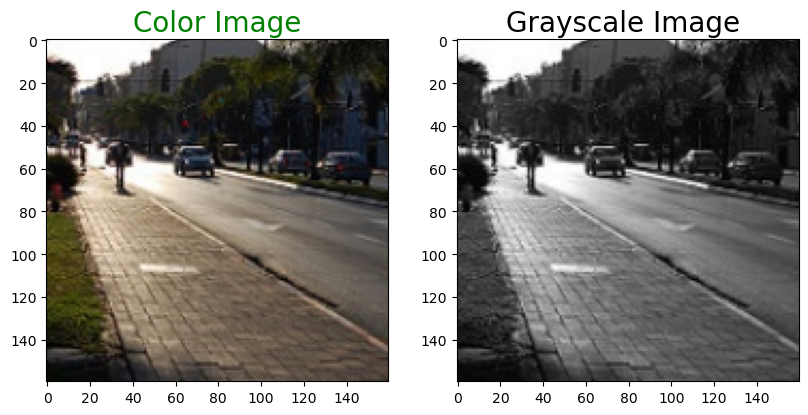

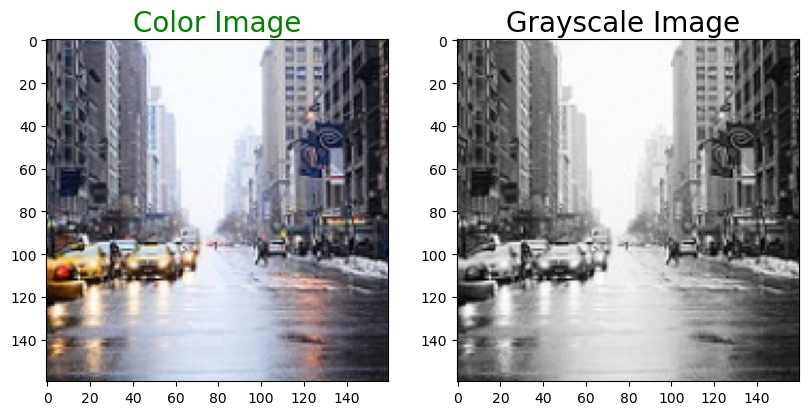

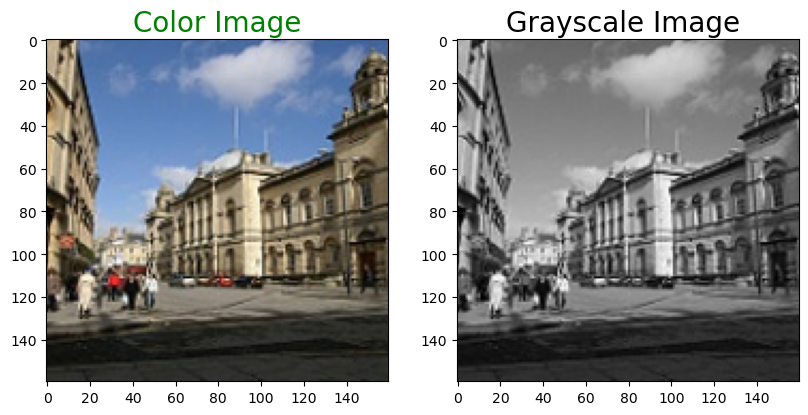

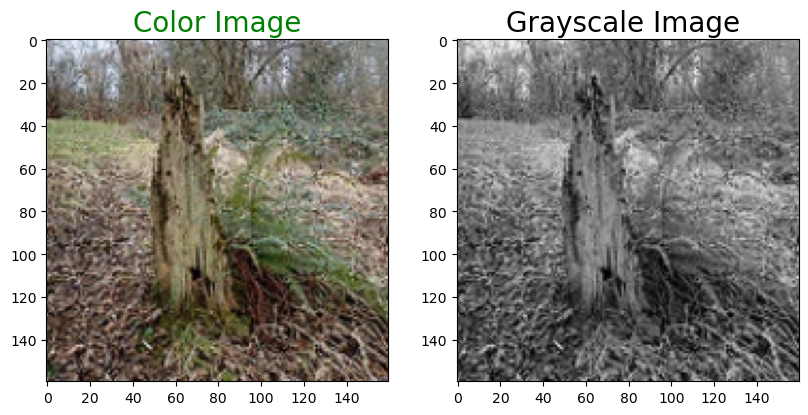

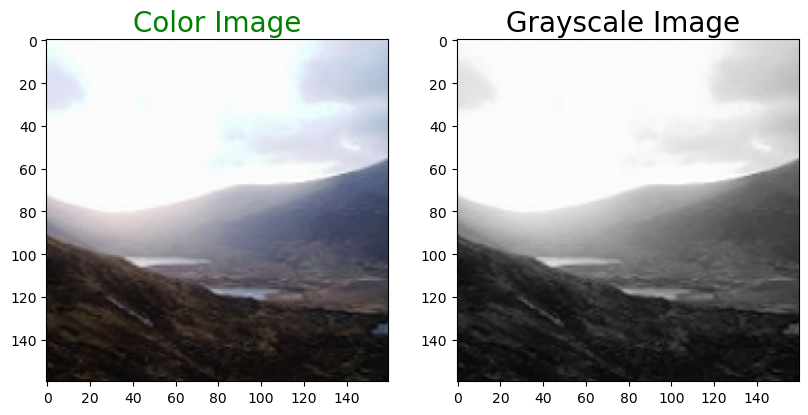

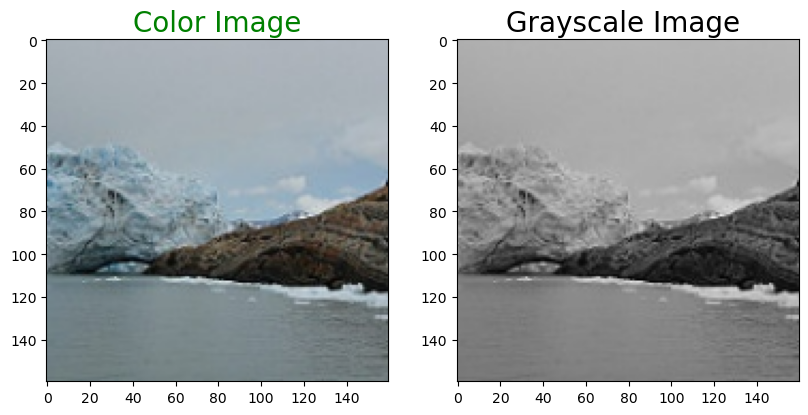

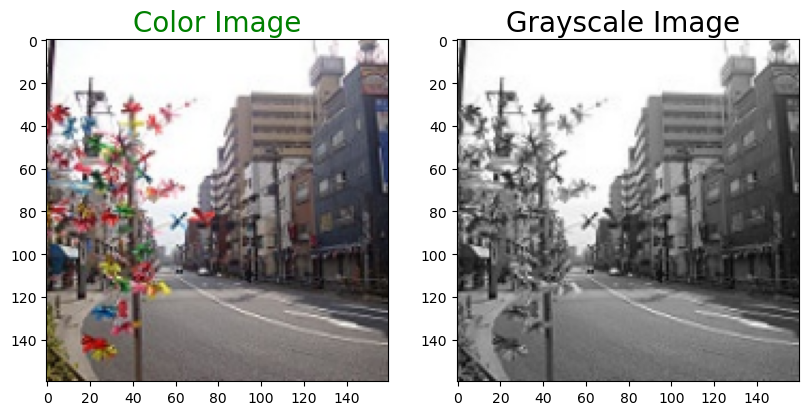

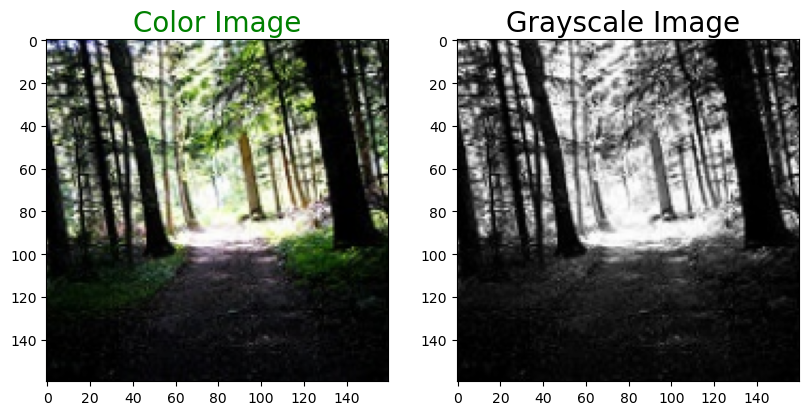

In [3]:
def plot_images(color,grayscale):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.show()

for i in range(20,30):
     plot_images(color_img[i],gray_img[i])

In [4]:
# train split 
len_data = len(color_img)
train_size = int(len_data*0.8)

train_gray_image = gray_img[:train_size]
train_color_image = color_img[:train_size]

test_gray_image = gray_img[train_size:]
test_color_image = color_img[train_size:]

train_g = np.reshape(train_gray_image,(len(train_gray_image),SIZE,SIZE,3))
train_c = np.reshape(train_color_image, (len(train_color_image),SIZE,SIZE,3))
print('Train color image shape:',train_c.shape)


test_gray_image = np.reshape(test_gray_image,(len(test_gray_image),SIZE,SIZE,3))
test_color_image = np.reshape(test_color_image, (len(test_color_image),SIZE,SIZE,3))
print('Test color image shape',test_color_image.shape)

Train color image shape: (5703, 160, 160, 3)
Test color image shape (1426, 160, 160, 3)


In [5]:
from AE_RESNET.resnetAE import ResNetAE
from AE_RESNET.resnetAE_mod import ResNetAE_mod

In [6]:
resnet18AEMod = ResNetAE_mod(input_shape=(SIZE,SIZE,3), output_channels=3, resnet_decoder=True)
resnet18AEMod.summary()

Model: "ResNetAEMod"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 ResNet_encoder (Functional)    (None, 5, 5, 512)    12604352    ['input_1[0][0]']                
                                                                                                  
 ResNet_decoder (Functional)    (None, 160, 160, 3)  17248911    ['ResNet_encoder[0][0]']         
                                                                                                  
 concatenate (Concatenate)      (None, 160, 160, 6)  0           ['input_1[0][0]',      

In [7]:
optimizer = keras.optimizers.Adam(learning_rate=0.001)
resnet18AEMod.compile(optimizer=optimizer, loss="mae")

early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = resnet18AEMod.fit(
    train_g,
    train_c,
    epochs=100,
    batch_size=64, 
    shuffle=True,
    validation_split=0.1, 
    callbacks=[early_stopping]
    )

Epoch 1/100
81/81 [==============================] - 49s 424ms/step - loss: 0.1406 - val_loss: 0.2649
Epoch 2/100
81/81 [==============================] - 30s 372ms/step - loss: 0.0815 - val_loss: 0.2072
Epoch 3/100
81/81 [==============================] - 30s 377ms/step - loss: 0.0708 - val_loss: 0.1172
Epoch 4/100
81/81 [==============================] - 30s 370ms/step - loss: 0.0659 - val_loss: 0.1060
Epoch 5/100
81/81 [==============================] - 30s 370ms/step - loss: 0.0631 - val_loss: 0.1044
Epoch 6/100
81/81 [==============================] - 30s 367ms/step - loss: 0.0613 - val_loss: 0.1076
Epoch 7/100
81/81 [==============================] - 29s 359ms/step - loss: 0.0599 - val_loss: 0.0831
Epoch 8/100
81/81 [==============================] - 29s 359ms/step - loss: 0.0585 - val_loss: 0.0894
Epoch 9/100
81/81 [==============================] - 29s 359ms/step - loss: 0.0574 - val_loss: 0.0839
Epoch 10/100
81/81 [==============================] - 29s 360ms/step - loss: 0.056

1/1 [==============================] - 0s 16ms/step


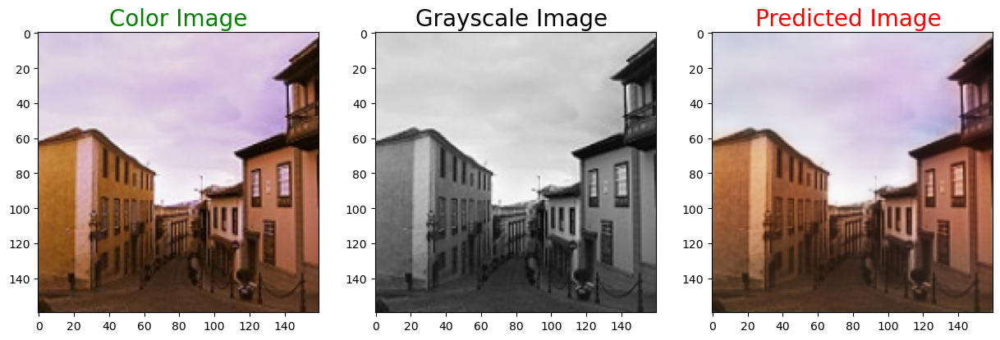

1/1 [==============================] - 0s 14ms/step


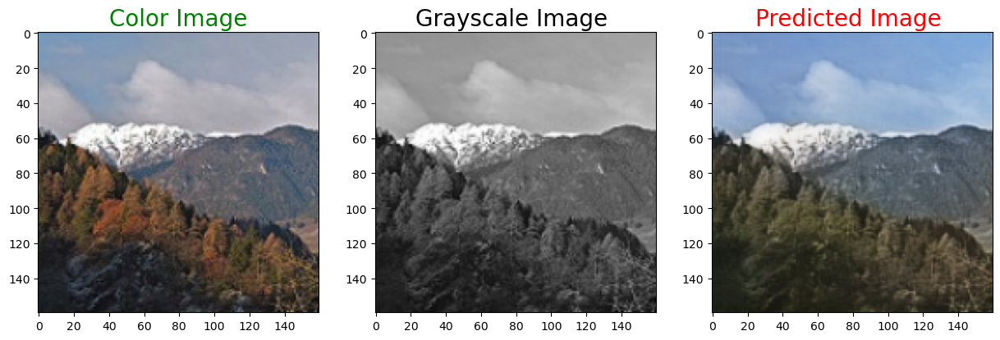

1/1 [==============================] - 0s 15ms/step


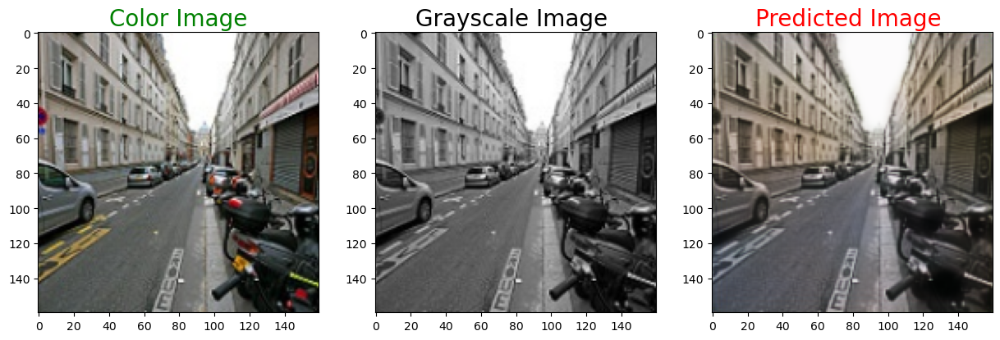

1/1 [==============================] - 0s 13ms/step


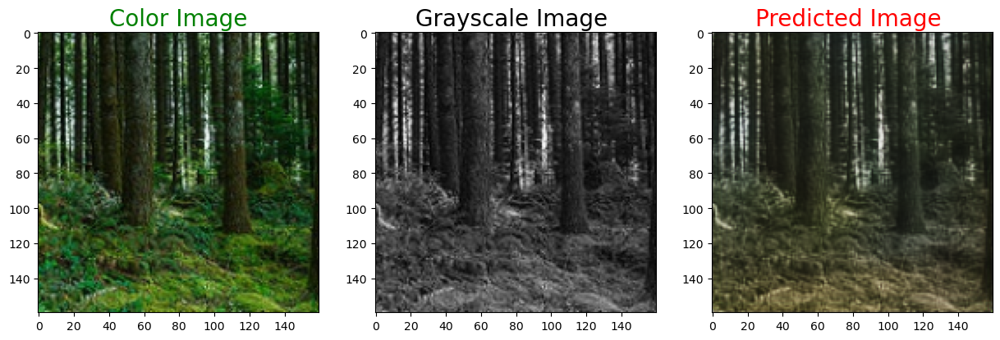

1/1 [==============================] - 0s 15ms/step


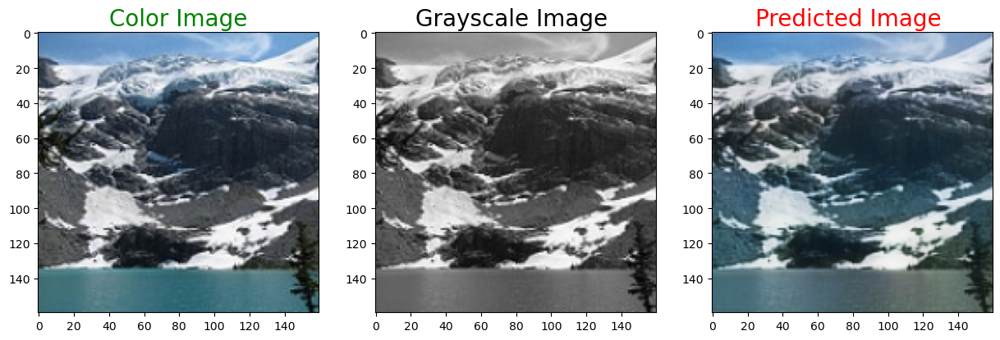

1/1 [==============================] - 0s 15ms/step


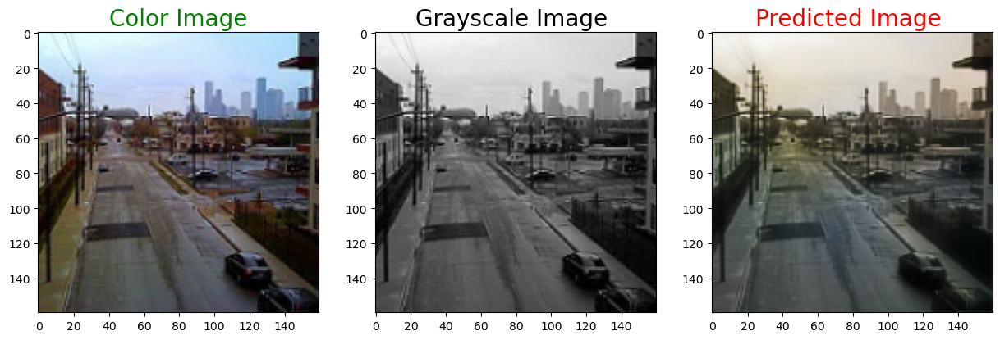

1/1 [==============================] - 0s 14ms/step


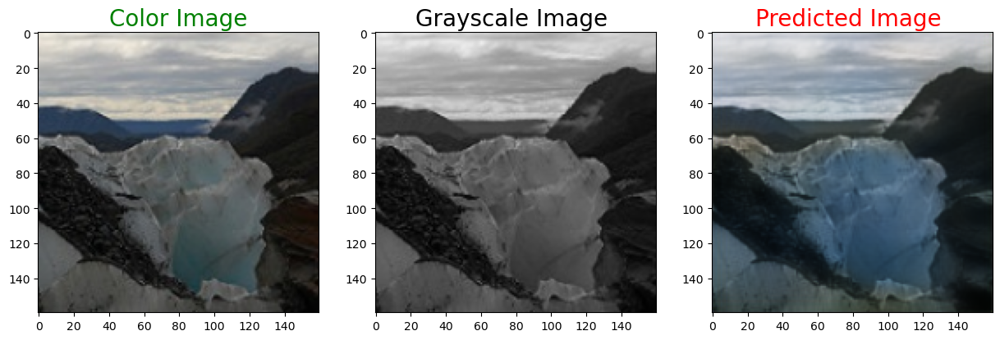

1/1 [==============================] - 0s 15ms/step


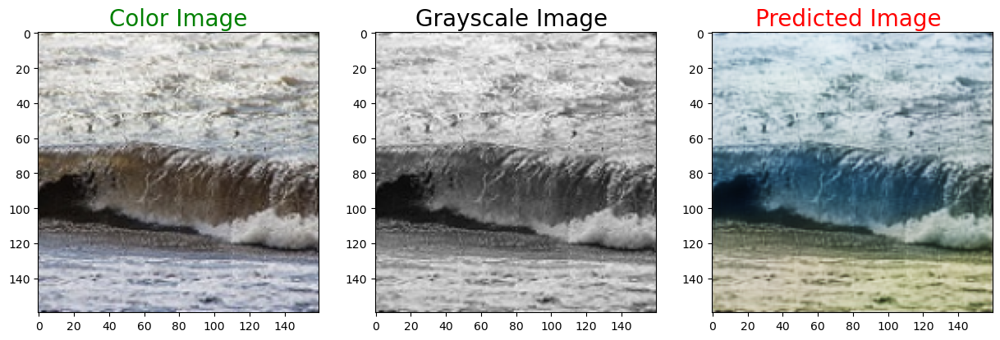

In [10]:
# defining function to plot images pair
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(75,83):
    predicted = np.clip(resnet18AEMod.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

1/1 [==============================] - 0s 16ms/step


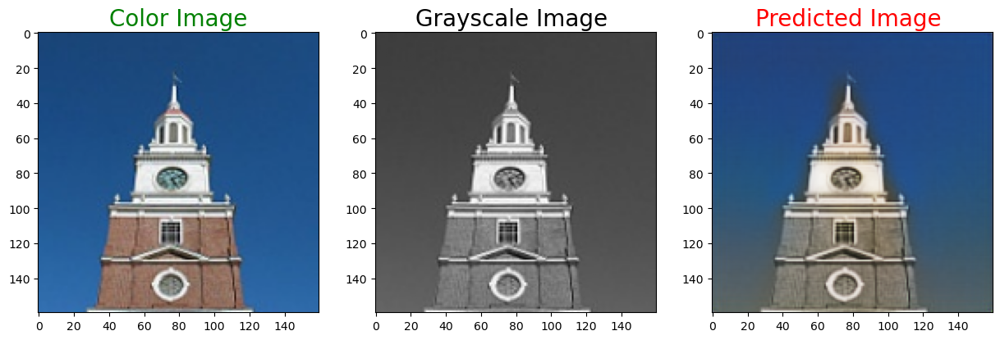

1/1 [==============================] - 0s 19ms/step


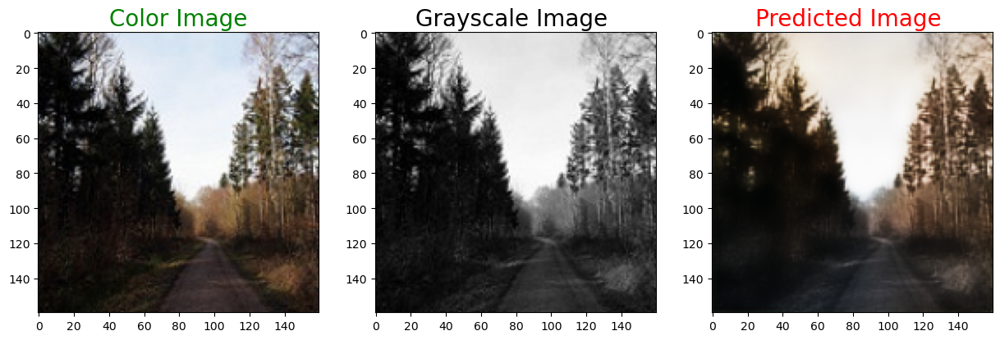

1/1 [==============================] - 0s 15ms/step


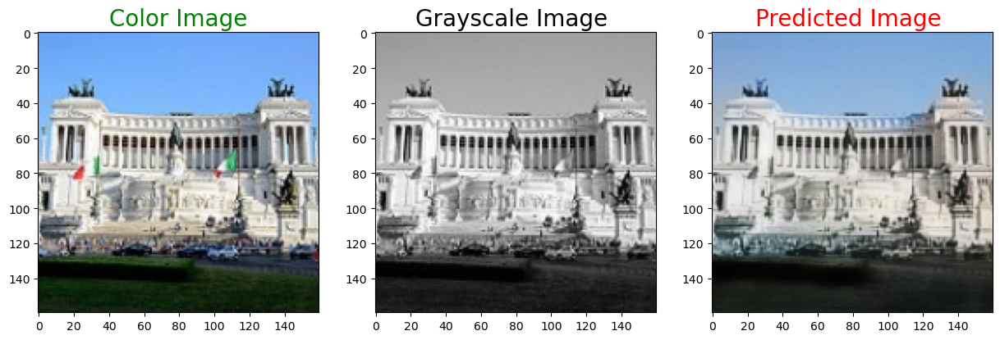

1/1 [==============================] - 0s 14ms/step


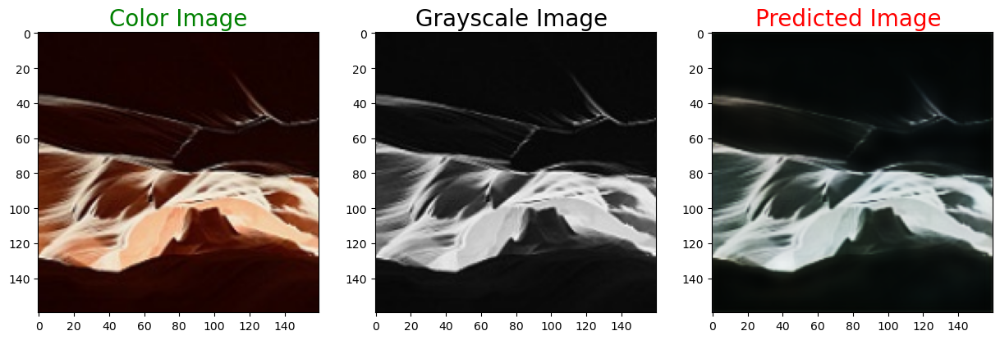

1/1 [==============================] - 0s 15ms/step


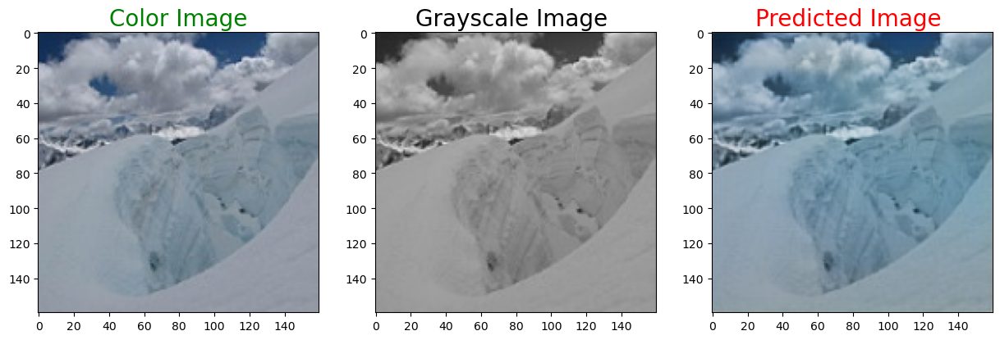

1/1 [==============================] - 0s 23ms/step


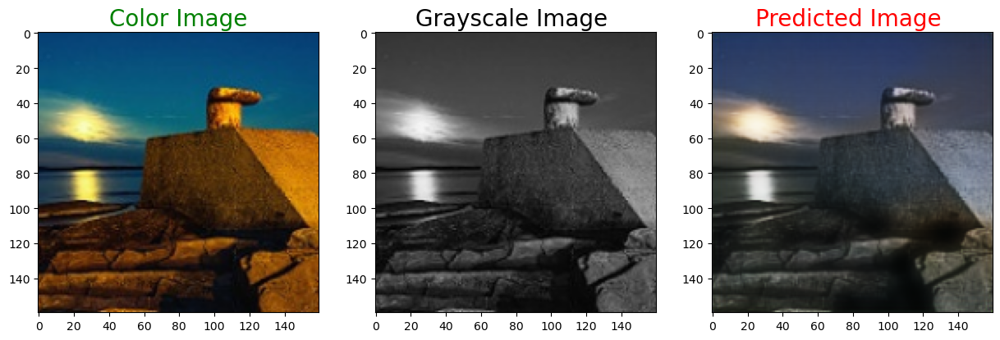

1/1 [==============================] - 0s 17ms/step


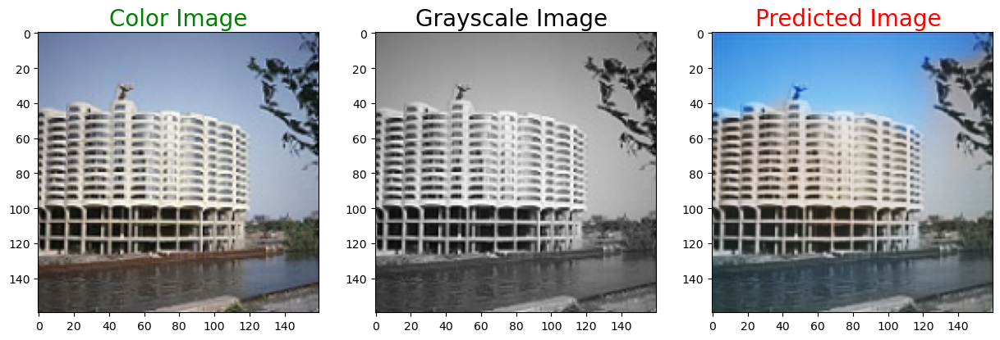

1/1 [==============================] - 0s 15ms/step


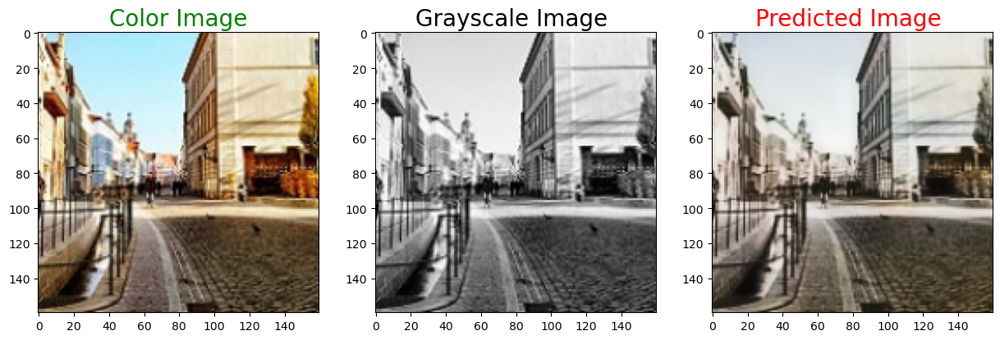

In [15]:
for i in range(500,508):
    predicted = np.clip(resnet18AEMod.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

In [11]:
resnet18AEMod.save('final_models/resnet18AE_mod_lr001.h5')

In [12]:
predictions = resnet18AEMod.predict(test_gray_image)
test_data_prue = np.squeeze(test_gray_image)
predictions_prue = np.squeeze(predictions)

resnet18AEMod.evaluate(test_data_prue, predictions_prue, channel_axis=-1)

45/45 [==============================] - 4s 66ms/step
SSIM: 0.9632568955421448
PSNR: 23.461804472960527


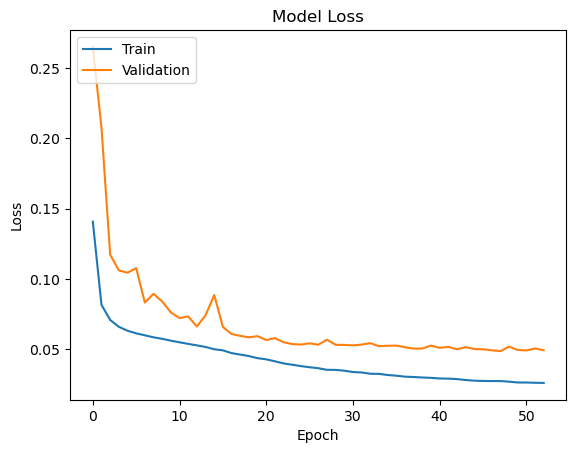

In [13]:
import matplotlib.pyplot as plt
import numpy as np

def plot_lr(history):
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

plot_lr(history)

In [27]:
resnet18AE = ResNetAE(input_shape=(SIZE,SIZE,3), output_channels=3, resnet_decoder=True)
resnet18AE.summary()

Model: "ResNetAE"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_7 (InputLayer)        [(None, 160, 160, 3)]     0         
                                                                 
 ResNet_encoder (Functional)  (None, 5, 5, 512)        12604352  
                                                                 
 ResNet_decoder (Functional)  (None, 160, 160, 3)      17248911  
                                                                 
Total params: 29,853,263
Trainable params: 29,833,929
Non-trainable params: 19,334
_________________________________________________________________


In [28]:
optimizer = keras.optimizers.Adam(learning_rate=0.0001)
resnet18AE.compile(optimizer=optimizer, loss="mae")

early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

history = resnet18AE.fit(
    train_g,
    train_c,
    epochs=40,
    batch_size=64, 
    shuffle=True,
    validation_split=0.1, 
    callbacks=[]
    )



Epoch 1/40
81/81 [==============================] - 31s 353ms/step - loss: 0.1505 - val_loss: 0.2166
Epoch 2/40
81/81 [==============================] - 28s 348ms/step - loss: 0.1167 - val_loss: 0.1912
Epoch 3/40
81/81 [==============================] - 28s 349ms/step - loss: 0.1083 - val_loss: 0.1673
Epoch 4/40
81/81 [==============================] - 28s 349ms/step - loss: 0.1054 - val_loss: 0.1434
Epoch 5/40
81/81 [==============================] - 28s 348ms/step - loss: 0.1018 - val_loss: 0.1234
Epoch 6/40
81/81 [==============================] - 28s 348ms/step - loss: 0.1003 - val_loss: 0.1040
Epoch 7/40
81/81 [==============================] - 28s 348ms/step - loss: 0.0972 - val_loss: 0.1037
Epoch 8/40
81/81 [==============================] - 28s 349ms/step - loss: 0.0947 - val_loss: 0.0990
Epoch 9/40
81/81 [==============================] - 28s 348ms/step - loss: 0.0927 - val_loss: 0.0996
Epoch 10/40
81/81 [==============================] - 28s 348ms/step - loss: 0.0912 - val_lo

1/1 [==============================] - 0s 380ms/step


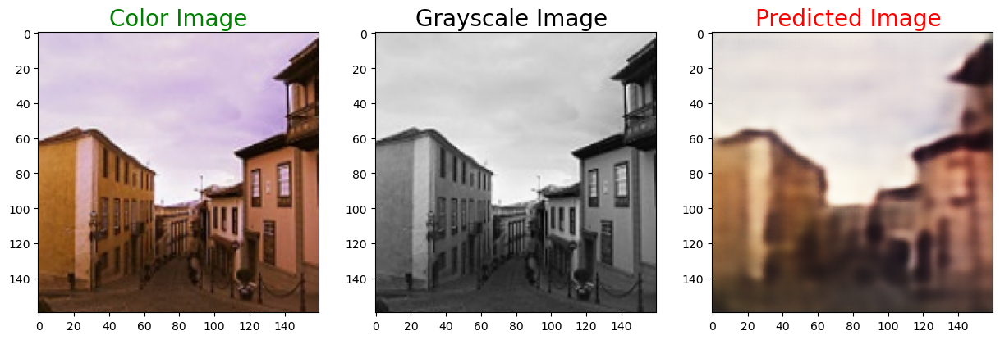

1/1 [==============================] - 0s 15ms/step


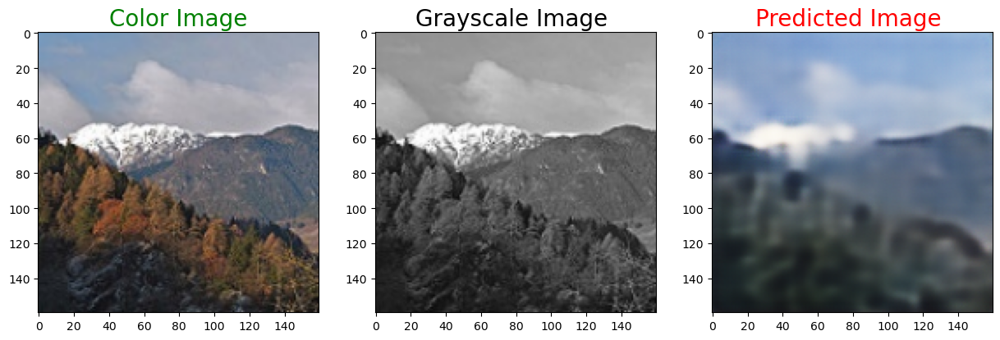

1/1 [==============================] - 0s 14ms/step


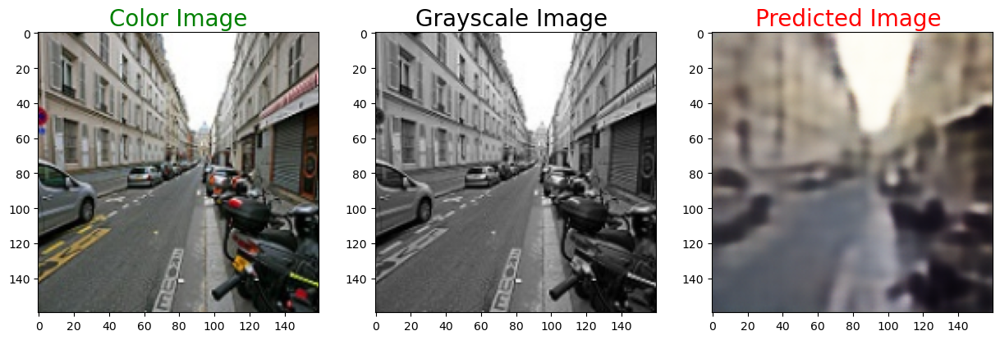

1/1 [==============================] - 0s 16ms/step


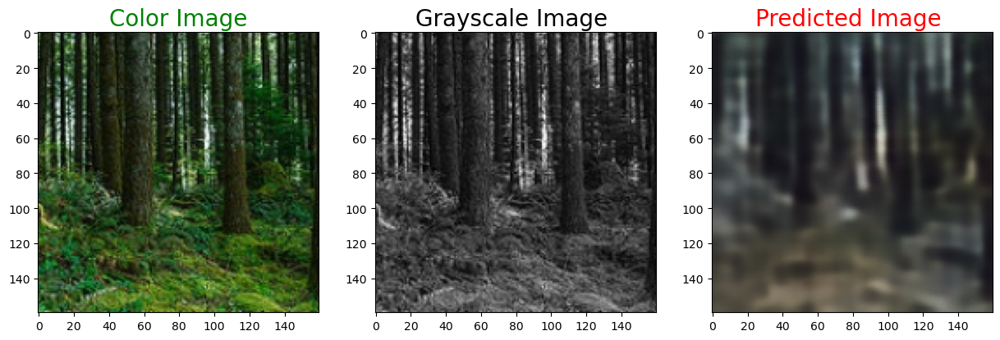

1/1 [==============================] - 0s 12ms/step


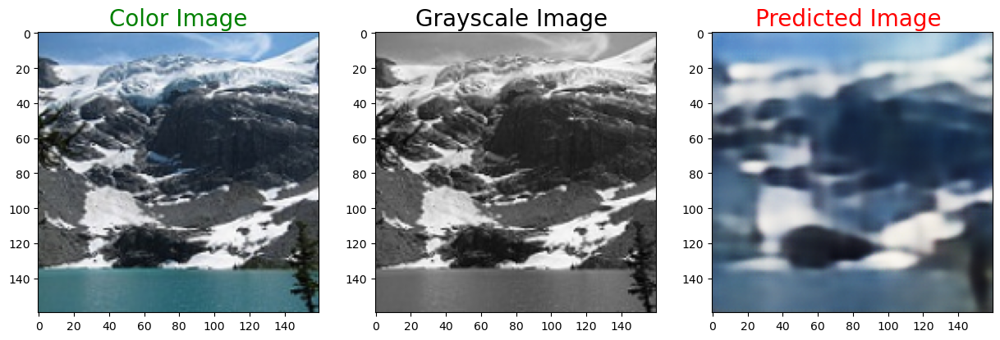

1/1 [==============================] - 0s 12ms/step


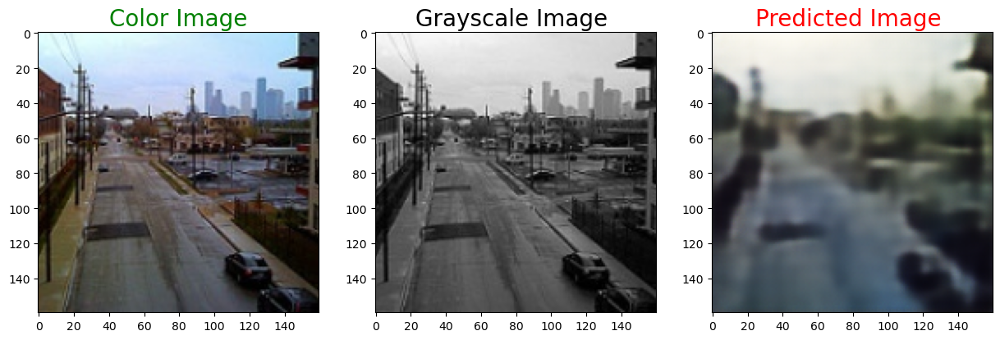

1/1 [==============================] - 0s 13ms/step


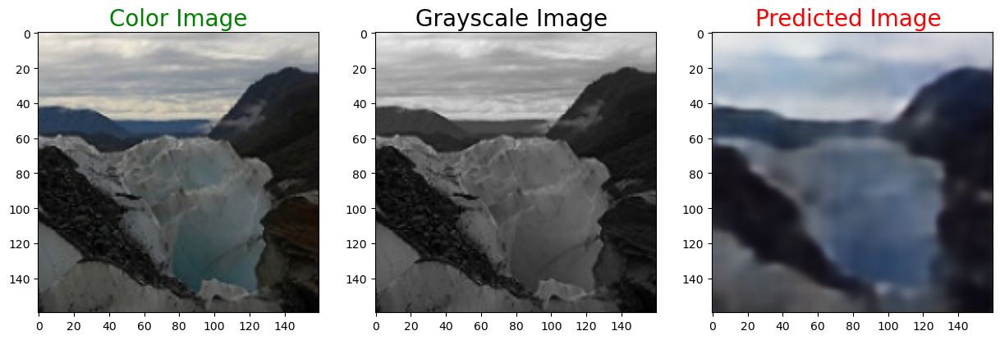

1/1 [==============================] - 0s 16ms/step


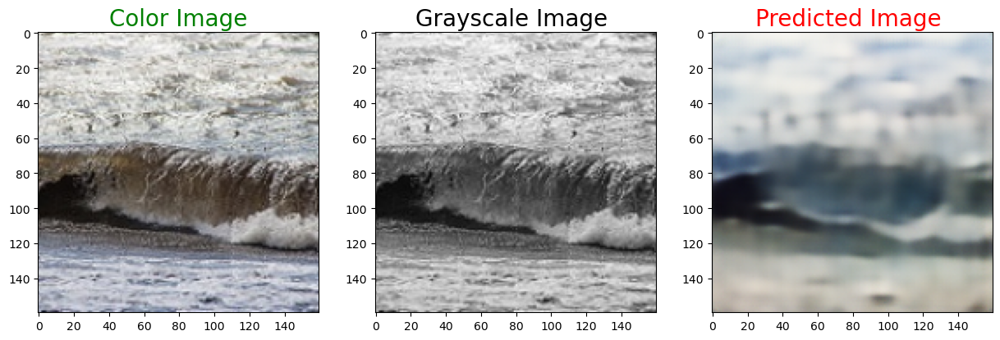

In [29]:
# defining function to plot images pair
def plot_images(color,grayscale,predicted):
    plt.figure(figsize=(15,15))
    plt.subplot(1,3,1)
    plt.title('Color Image', color = 'green', fontsize = 20)
    plt.imshow(color)
    plt.subplot(1,3,2)
    plt.title('Grayscale Image ', color = 'black', fontsize = 20)
    plt.imshow(grayscale)
    plt.subplot(1,3,3)
    plt.title('Predicted Image ', color = 'Red', fontsize = 20)
    plt.imshow(predicted)
   
    plt.show()

for i in range(75,83):
    predicted = np.clip(resnet18AE.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

1/1 [==============================] - 0s 15ms/step


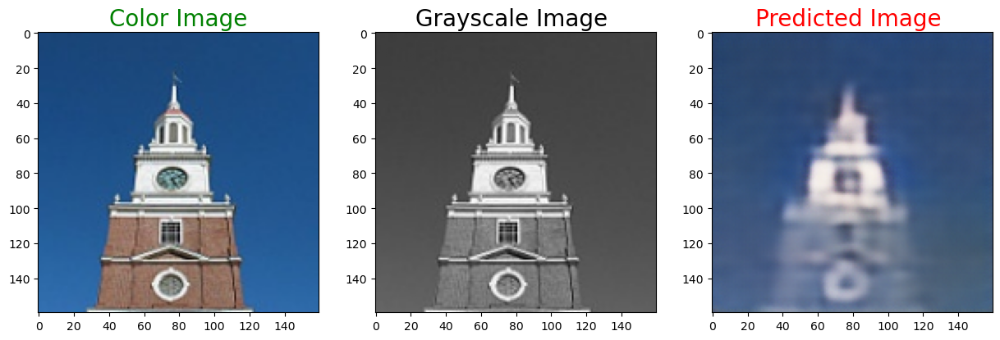

1/1 [==============================] - 0s 23ms/step


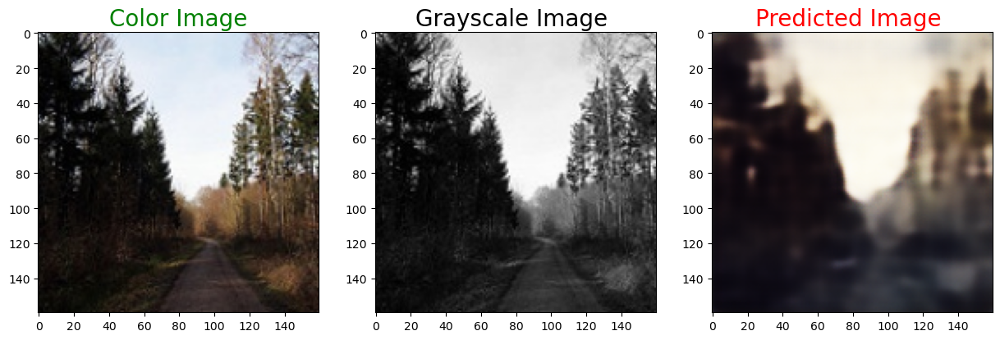

1/1 [==============================] - 0s 13ms/step


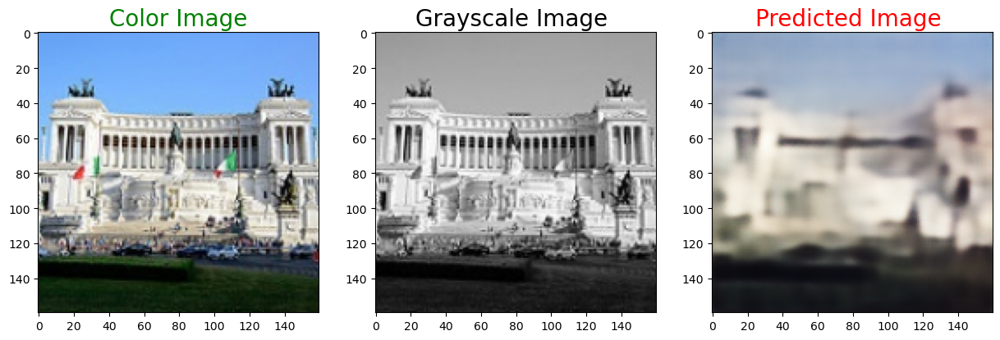

1/1 [==============================] - 0s 14ms/step


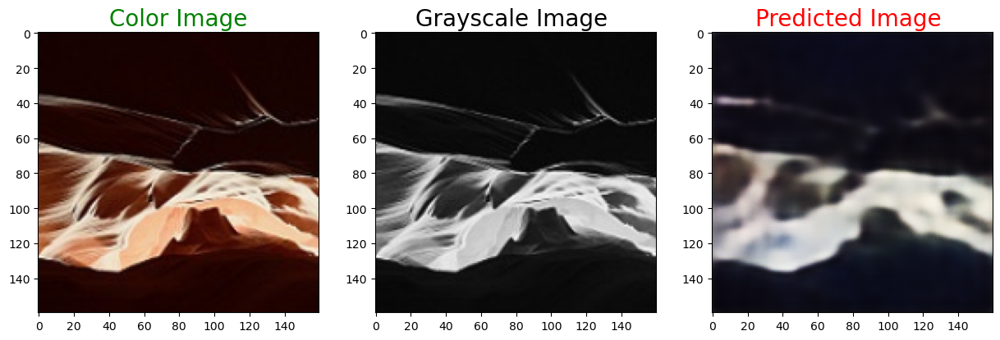

1/1 [==============================] - 0s 14ms/step


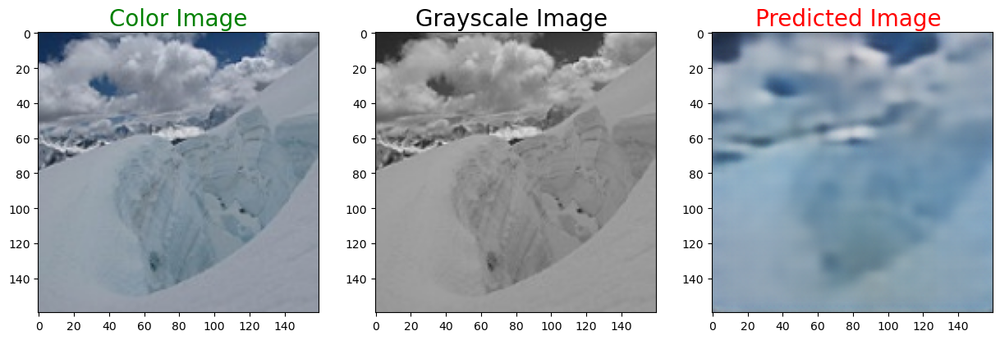

1/1 [==============================] - 0s 14ms/step


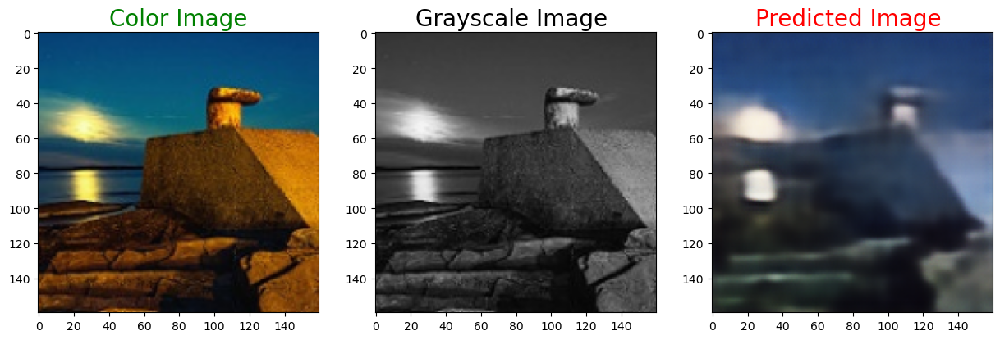

1/1 [==============================] - 0s 16ms/step


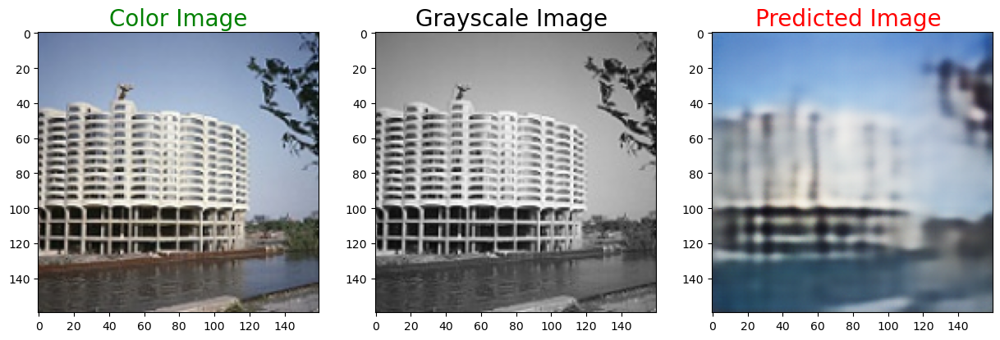

1/1 [==============================] - 0s 17ms/step


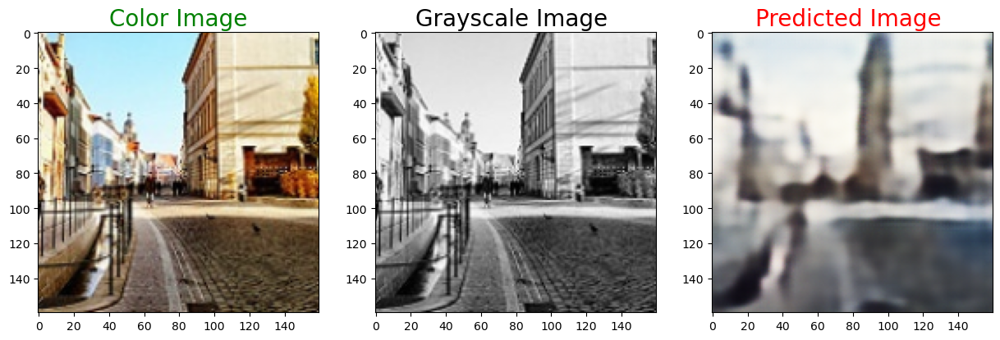

In [31]:
for i in range(500,508):
    predicted = np.clip(resnet18AE.predict(test_gray_image[i].reshape(1,SIZE, SIZE,3)),0.0,1.0).reshape(SIZE, SIZE,3)
    plot_images(test_color_image[i],test_gray_image[i],predicted)

In [32]:
predictions = resnet18AE.predict(test_gray_image)
test_data_prue = np.squeeze(test_gray_image)
predictions_prue = np.squeeze(predictions)

45/45 [==============================] - 4s 65ms/step


In [33]:
resnet18AE.evaluate(test_data_prue, predictions_prue, channel_axis=-1)

SSIM: 0.8829553127288818
PSNR: 19.512924762811277


In [34]:
resnet18AE.save('final_models/resnet18AE_lr0001.h5')

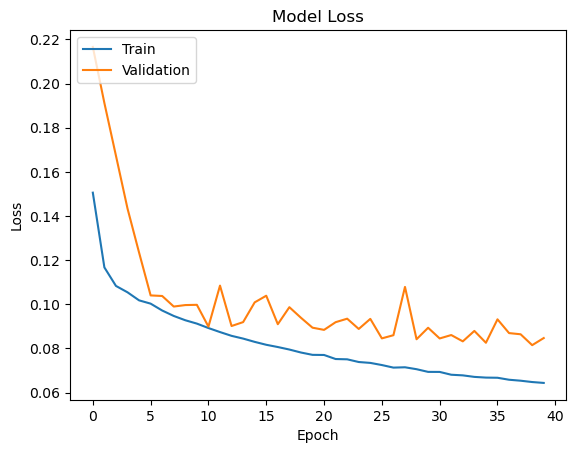

In [37]:
plot_lr(history)